\


This is more advanced notebook on how use `easyXRD`. We explain more keywords on loading and refining.\
See the next notebook `03_advanced.ipynb` for more advanced features once you successfully run all cells in this notebook.

\

<table class="ee-notebook-buttons" align="left"><td>
<a target="_blank"  href="https://colab.research.google.com/github/MehmetTopsakal/easyXRD/blob/main/examples/02_intermediate.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" /> Run in this notebook on Google Colab</a>
</td><td>
<a target="_blank"  href="https://github.com/MehmetTopsakal/easyXRD/blob/main/examples/02_intermediate.ipynb"><img width=32px src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" /> View source on GitHub</a></td></table>

\

In order to run this notebook on Google Colab (https://colab.research.google.com/), we need:

* `easyXRD` [package](https://github.com/MehmetTopsakal/easyXRD) from GitHub,

* `examples/data` folder that comes with easyXRD cloned from GitHub,

* A `zip` file that contains GSAS-II python files from a Google Drive [link](https://drive.google.com/file/d/1IVwLaPvMjP3kZGgA4la4XBROY4pDjb9j/view?usp=sharing) and extract it to colab instance.




By executing the next cell (`Shift + Enter`) , we do all these necessary steps above. Note that everything runs on Google Colab!

In [1]:
# This clones easyXRD repo from GitHub
!! git clone https://github.com/MehmetTopsakal/easyXRD.git
# This copies contents of `easyXRD/examples/data` to working diractory of this notebook,
!! cp -r easyXRD/examples/data/* .
# This gets GSAS-II zip file file from Mehmet Topsakal's Google Drive share and extracts it
!! gdown 1IVwLaPvMjP3kZGgA4la4XBROY4pDjb9j -O gsas2_v5038.zip; unzip -u gsas2_v5038.zip -d /root
! echo done!

done!


In [2]:
import sys
sys.path += ["easyXRD"] # Adding easyXRD python package that we cloned from GitHub into sys
from easyxrd.core import exrd # import exrd class

# importing matplotlib for plots with interactive support.
%matplotlib widget
import matplotlib.pyplot as plt

plt.rcParams["figure.constrained_layout.use"] = True # For better plots.

# Enabling custom widget for "%matplotlib widget" line above to work in Colab
from google.colab import output
output.enable_custom_widget_manager()

import os
import fabio



Checking required packages:

---ipympl package with version 0.9.4 is available and can be imported 
---pymatgen package with version 2024.10.3 is available and can be imported 
---pybaselines package with version 1.1.0 is available and can be imported 
---scipy package with version 1.13.1 is available and can be imported 
---numpy package with version 1.26.4 is available and can be imported 
---xarray package with version 2024.9.0 is available and can be imported 
---pyFAI package with version 2024.9.0 is available and can be imported 
---pandas package with version 2.2.2 is available and can be imported 
---mp_api package with version 0.42.2 is available and can be imported 
---fabio package with version 2024.9.0 is available and can be imported 


Imported easyxrd with the following configuration:

easyxrd_scratch_path : /root/.easyxrd_scratch
gsasii_lib_path : /root/g2full/GSAS-II/GSASII
mp_api_key : none......


In [3]:
# We can list the contents of currant working directory with listdir command
os.listdir()

['.config',
 'gsas2_v5038.zip',
 'Kapton',
 'LaB6',
 'geometry.poni',
 'maks.edf',
 'LaB6.gpx',
 'mask.edf',
 'easyXRD',
 'LaB6_CeO2_mix',
 'CeO2',
 'easyXRD.tar.gz',
 'sample_data']

# LaB6

Here we start with LaB6/img.tiff which is actually 2D raw image of `LaB6_synchrotron_XRD_from_28ID-2.xy` file we used in previous notebook.

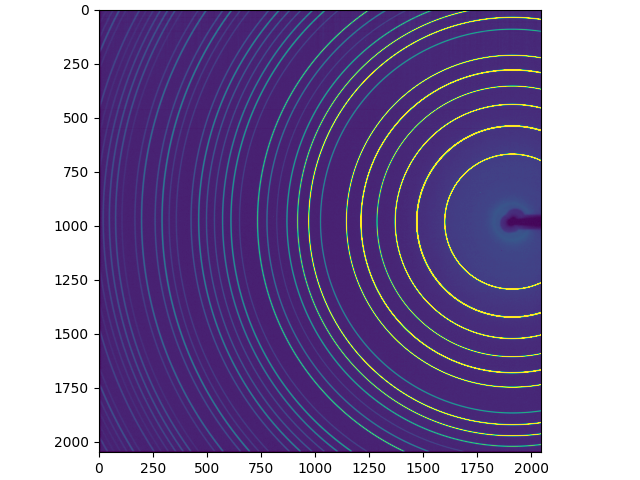

In [4]:
# We can display the LaB6/img.tiff as below.
plt.figure()
plt.imshow(fabio.open('LaB6/img.tiff').data,vmin=0,vmax=100)

In order to radially integrate this 2D image, we need to use [pyFAI](https://pyfai.readthedocs.io/en/stable/).

Please refer to resources below about pyFAI usage.

* https://www.youtube.com/watch?v=hqp0UyvepXk&ab_channel=ESRFsynchrotron
* https://github.com/MehmetTopsakal/pySULI/blob/main/notebooks/003_learn_pyFAI.ipynb


We have provided a poni file `geometry.poni` in the working directory. It is basically a text file with the information below. Please refer to  pyFAI documentation about the meaning of poni file.

<ul>
# Nota: C-Order, 1 refers to the Y axis, 2 to the X axis<br>
# Calibration done at Mon Apr  8 17:18:53 2024<br>
poni_version: 2.1<br>
Detector: Perkin\
Detector_config: {"pixel1": 0.0002, "pixel2": 0.0002, "orientation": 3}<br>
Distance: 1.4280248574010523<br>
Poni1: 0.23404917788488025<br>
Poni2: 0.3766844373109601<br>
Rot1: -0.0037624252170773112<br>
Rot2: -0.026178177480714798<br>
Rot3: -7.996604624242792e-10<br>
Wavelength: 1.814e-11<br>
</ul>

In the 2D image above, there are some areas such as beamstop shadow, bad pixels and the edges of the detector that we need to mask. You can use `pyFAI-drawmask` executable that comes with pyFAI package. See https://pyfai.readthedocs.io/en/v2023.1/man/pyFAI-drawmask.html We have provided a mask file as displayed below.

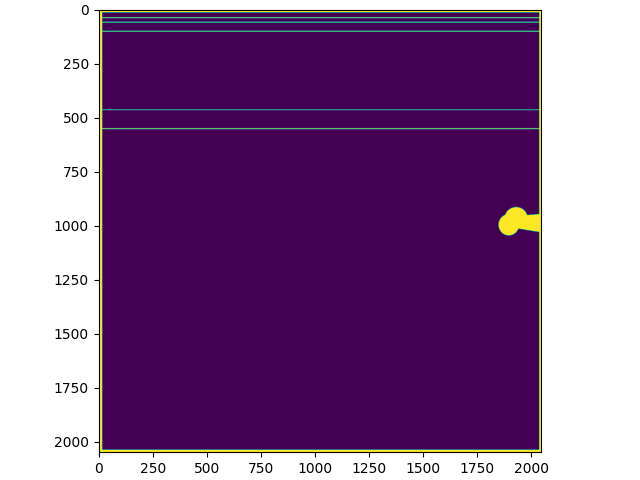

In [5]:
plt.figure()
plt.imshow(fabio.open('mask.edf').data)

In [6]:
# We believe, we made it quite straightforward to read and integrate a given 2D detector tiff file using easyXRD.

# As usual, we need to initialize exrd object.
sample = exrd()

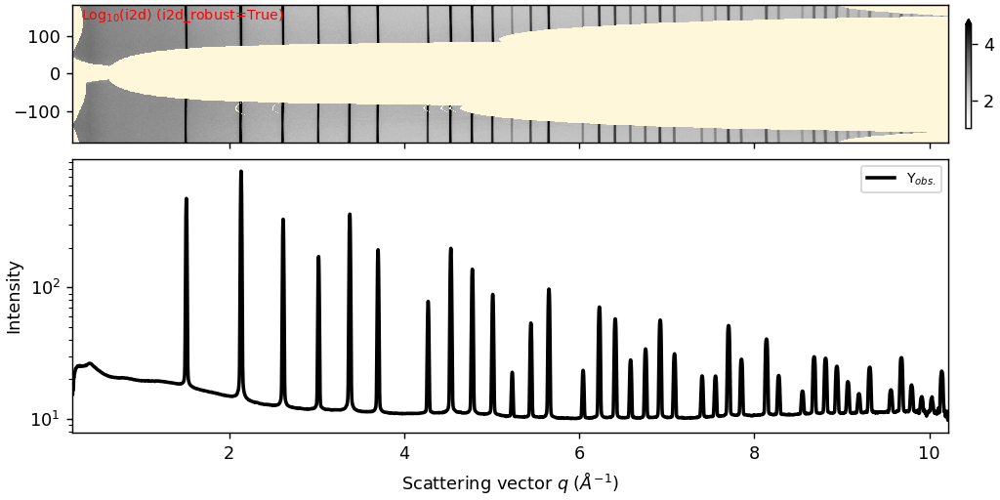

In [7]:
sample.load_xrd_data(
    from_tiff_file='LaB6/img.tiff', # image file
    poni_file='geometry.poni', # poni file you can get from pyFAI-calib2.
    mask_file='mask.edf', # maks file you can get from pyFAI-drawmask.
    )

# The bottom subplot in the figure below is same as 1D profile we loaded in previous notebook, 01_basic.ipynb.
# The new information is 2D image (i2d) in the upper subplot. It is basically reorganized data of LaB6/img.tiff
# we plotted in the first figure above. XRD community calls it as "cake". The yellow-ish parts are masked regions.
# If we average this image in y-direction, we get the 1D profile that we call as "i1d".

ImportError for wx/mpl in GSASIIctrlGUI: ignore if docs build

 ⏩--1st refinement with LeBail is completed. Rwp/GoF is 29.421/1.277 

 ✅--Background with 10 coeffs is refined. Rwp/GoF is now 17.649/0.767 (was 29.421(-40.01%)/1.277(-39.98%✨))
 ✅--Cell parameters are refined. Rwp/GoF is now 6.865/0.298 (was 17.649(-61.10%)/0.767(-61.12%✨))
 ✅--Instrument parameter ['U'] is refined. Rwp/GoF is now 6.742/0.293 (was 6.865(-1.79%)/0.298(-1.79%))
 ✅--Instrument parameter ['V'] is refined. Rwp/GoF is now 6.695/0.291 (was 6.742(-0.70%)/0.293(-0.70%❗))
 ✅--Instrument parameter ['W'] is refined. Rwp/GoF is now 6.630/0.288 (was 6.695(-0.96%)/0.291(-0.96%❗))
 ✅--Instrument parameter ['Zero'] is refined. Rwp/GoF is now 6.537/0.284 (was 6.630(-1.41%)/0.288(-1.41%))
 ✅--Cell parameters are refined. Rwp/GoF is now 6.507/0.283 (was 6.537(-0.46%)/0.284(-0.46%❗))
 ✅--Background with 15 coeffs is refined. Rwp/GoF is now 6.233/0.271 (was 6.507(-4.21%)/0.283(-4.14%))


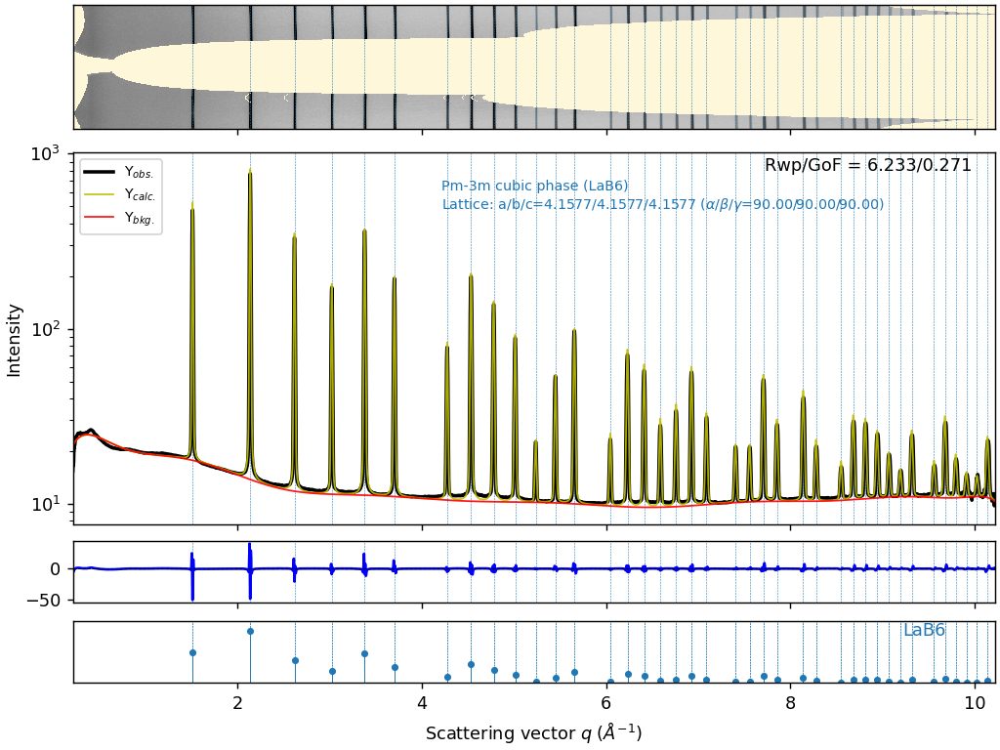

In [8]:
# Now we can refine this sample information using easyXRD as we did in previous notebook.

sample.load_phases(
    [{"cif": "LaB6/LaB6_structure_from_MaterialsProject.cif", "label": "LaB6"}], plot=False
)
sample.setup_gsas2_refiner(plot=False)

sample.refine_background(plot=False)
sample.refine_cell_parameters(plot=False)
sample.refine_instrument_parameters(inst_pars_to_refine=["U"], plot=False)
sample.refine_instrument_parameters(inst_pars_to_refine=["V"], plot=False)
sample.refine_instrument_parameters(inst_pars_to_refine=["W"], plot=False)
sample.refine_instrument_parameters(inst_pars_to_refine=["Zero"], plot=False)

# We can re-refine background since we improved instrument parameters in previous steps
sample.refine_cell_parameters(plot=False)

# We can re-refine background with higher number of coefficients
sample.refine_background(num_coeffs=15, plot=False)

sample.plot()

If you zoom in to high-q regions in the above plot you will see that the Yobs. is getting noisy. The reason is clear \
in the 12d information. Because, those regions correspponds to the edge of the detector and less pixels contribute to \
the data making the i1d plot noisy. Therefore, we can exlude those regions and the low q areas corresponding to beam-stop \
with the `radial_range=[1, 9.5]` keyword as we did in previous notebook `01_basic.ipynb`. We believe, this is a strength \
of `easyXRD`. We can see the raw data alongside 1d profile. To the best of our knowledge, no other programs such as
`TOPAS, GSAS-II or FullPro...` has this functionality.

In [9]:
# Now we can export refined as LaB6 GSAS-II project file (gpx).
sample.export_gpx_to('LaB6.gpx')

# CeO2

Now we can continue with `CeO2` NIST powder (https://tsapps.nist.gov/srmext/certificates/674b.pdf ) XRD data which was collected in same beamline conditions.


In [10]:
# As usual, we need to initialize exrd object.
sample = exrd()

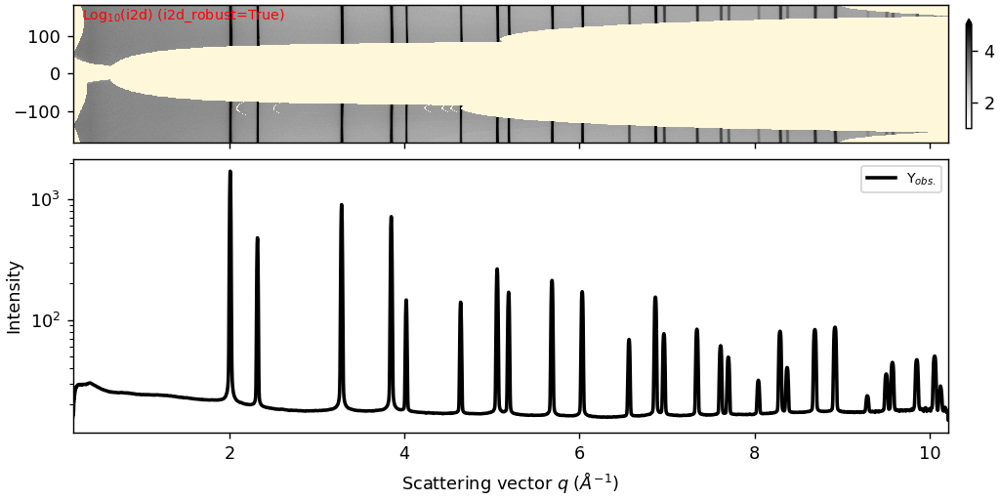

In [11]:
sample.load_xrd_data(
    from_tiff_file='CeO2/img.tiff', # image file
    poni_file='geometry.poni', # poni file you can get from pyFAI-calib2.
    mask_file='mask.edf', # maks file you can get from pyFAI-drawmask.
    )

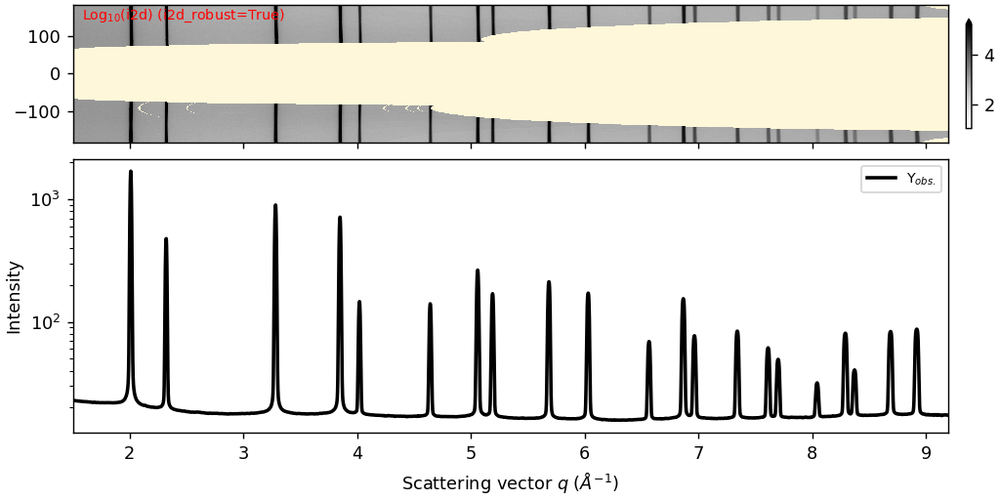

In [12]:
# Based on plot above, it would be good to limit q_range from 1.5 to 9.2

sample.load_xrd_data(
    from_tiff_file='CeO2/img.tiff', # image file
    poni_file='geometry.poni', # poni file you can get from pyFAI-calib2.
    mask_file='mask.edf', # maks file you can get from pyFAI-drawmask.
    radial_range=[1.5, 9.2]
    )

Retrieving MaterialsDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

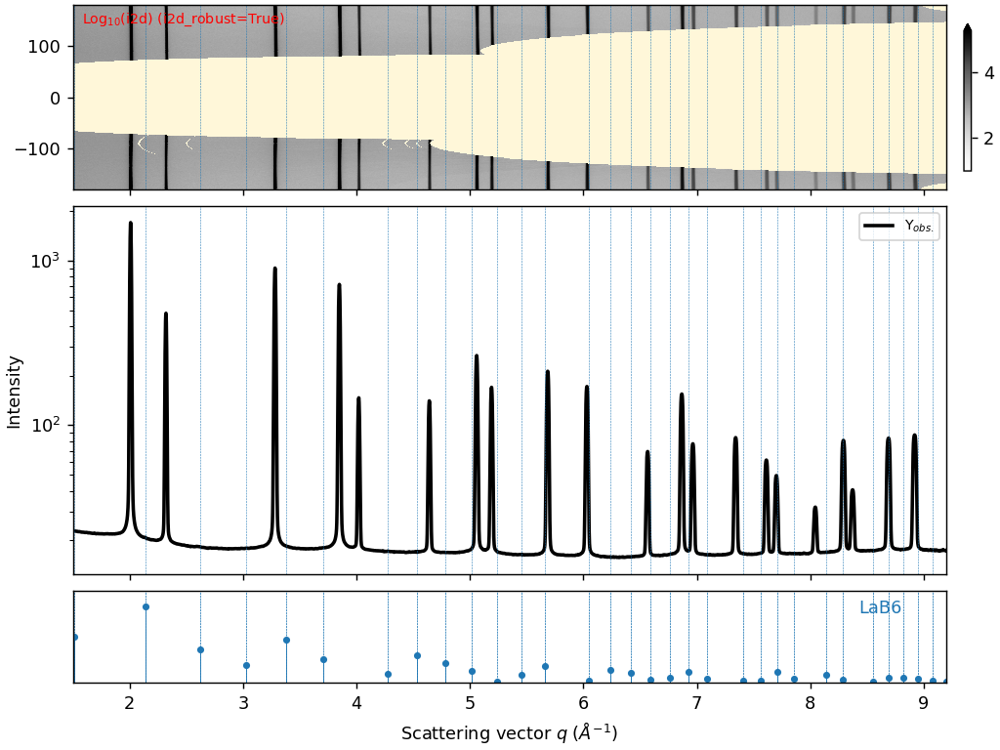

In [13]:
# Lets try LaB6 Materials Project id (mp-2680) in this CeO2 XRD.

sample.load_phases(
    [{"mp_id": "mp-2680", "label": "LaB6"}],
    plot=True,
    mp_rester_api_key='dHgNQRNYSpuizBPZYYab75iJNMJYCklB',
    )

# Obviously, it doesn't match CeO2 loaded here.

Retrieving MaterialsDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

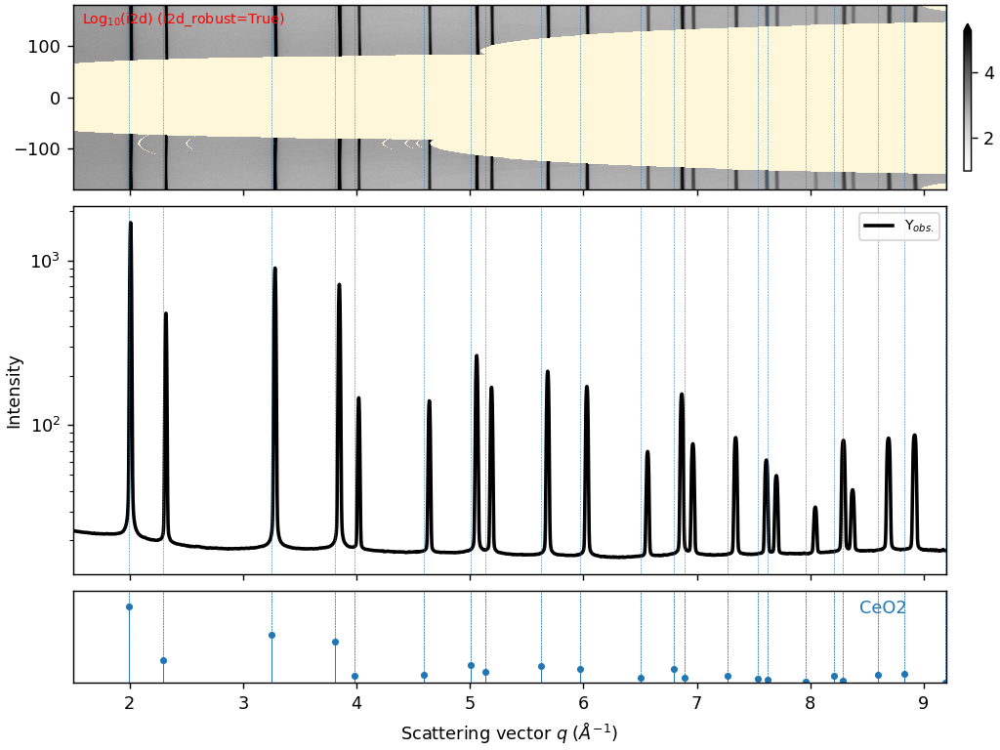

In [14]:
# The correct structure id should be mp-20194 for CeO2.pdf.
# https://legacy.materialsproject.org/materials/mp-20194/

sample.load_phases(
    [{"mp_id": "mp-20194", "label": "CeO2"}],
    plot=True,
    mp_rester_api_key='dHgNQRNYSpuizBPZYYab75iJNMJYCklB',
    )

# This sturucture works for the Yobs. for small q values. But it gets worse for high q-values.
# This is a result of wrongly calculated lattice constant of CeO2 on Materials Project.
# Before correcting the value, let's see whether the XRD refinement will get the correct lattice.


 ⏩--1st refinement with LeBail is completed. Rwp/GoF is 63.121/0.852 



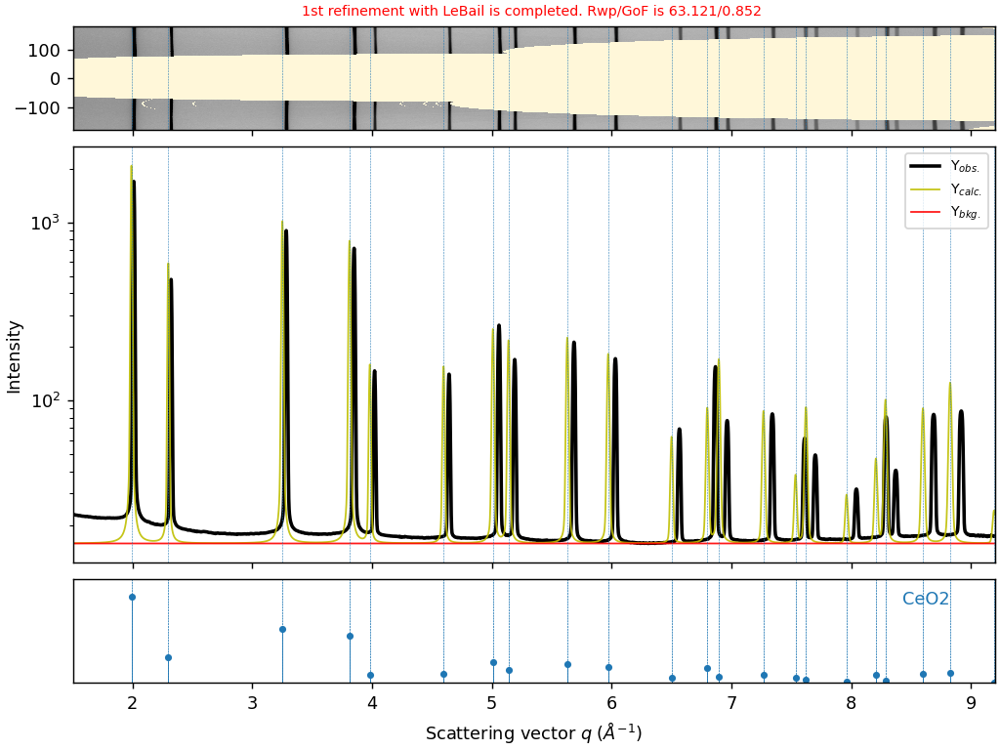

In [15]:
# Here we proceed with refinement.
# Since we refined the instrument parameters previously on LaB6, ideally we shouldn't refine it for CeO2.
# We can use instprm_from_gpx keyword in setup_gsas2_refiner to use refined instrument parameters.

sample.setup_gsas2_refiner(plot=True, normalize=True, instprm_from_gpx='LaB6.gpx')

# As a result, refinement is very poor. Because of the lattice.

 ✅--Cell parameters are refined. Rwp/GoF is now 63.079/0.851 (was 63.121(-0.07%)/0.852(-0.06%❗))


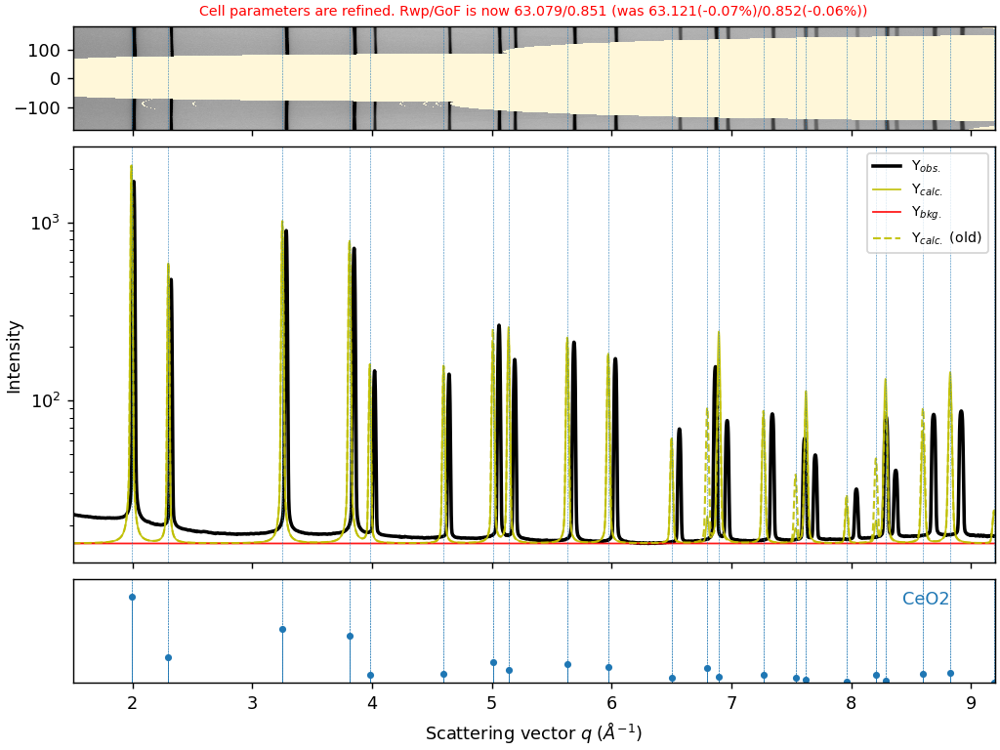

In [16]:
# Let's refine the cell parameters.

sample.refine_cell_parameters(plot=True)

# Obviously, the cell refinement was not able to find correct lattice, hence it is still a poor fit.

Retrieving MaterialsDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]


 ⏩--1st refinement with LeBail is completed. Rwp/GoF is now 11.069/0.149 (was 63.121(-82.46%)/0.852(-82.46%✨)) 

 ✅--Cell parameters are refined. Rwp/GoF is now 10.819/0.146 (was 11.069(-2.26%)/0.149(-2.26%))


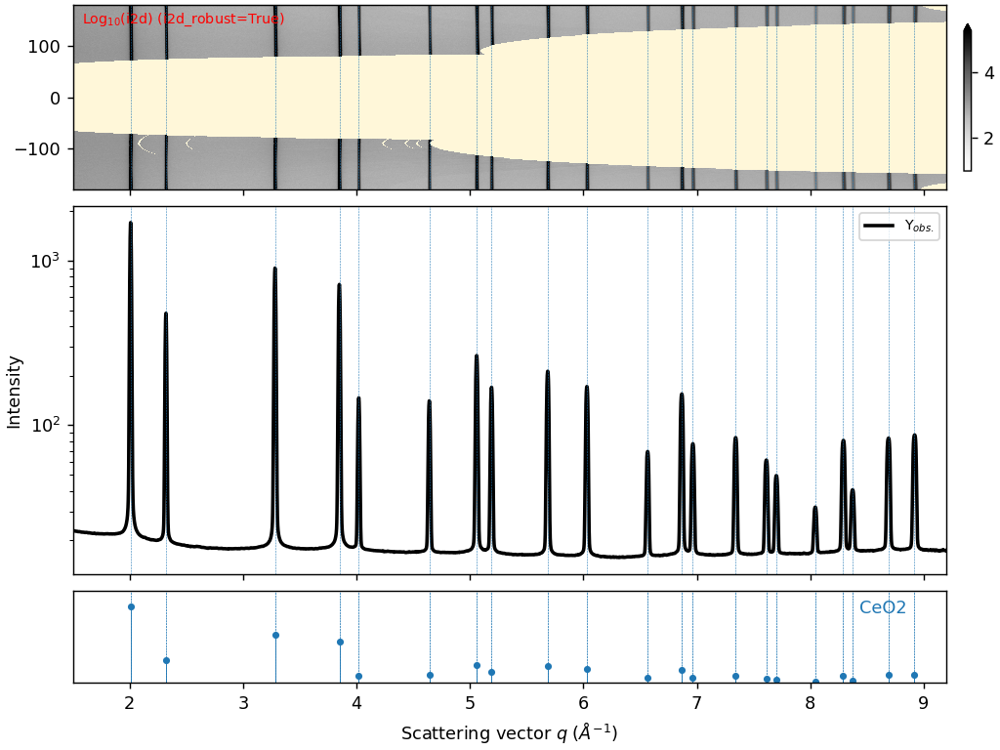

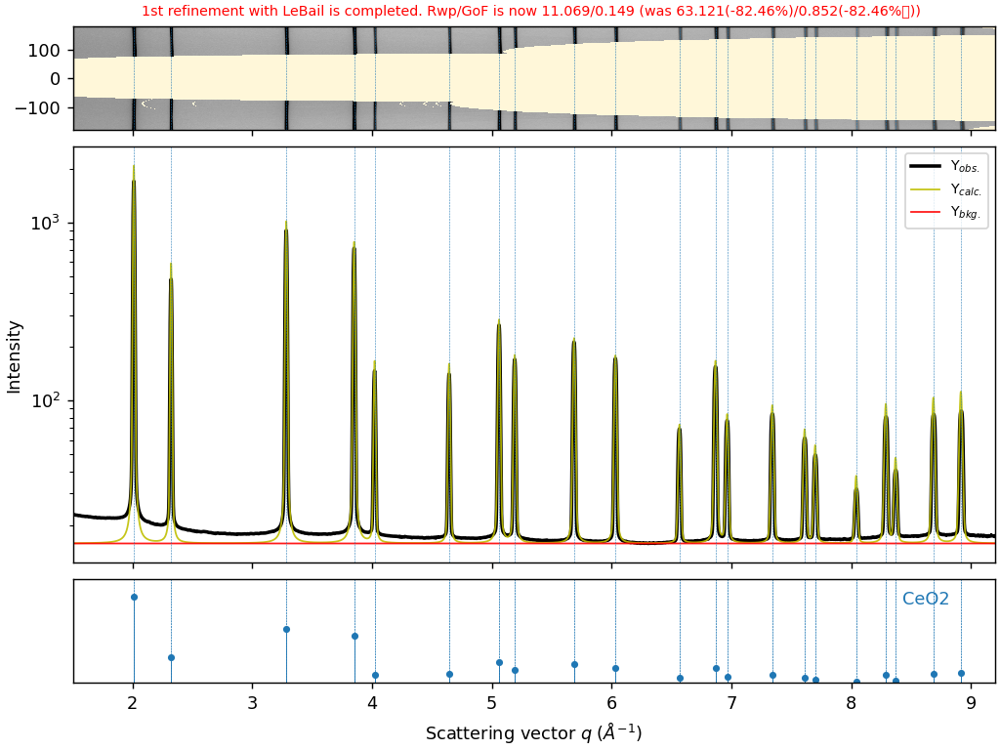

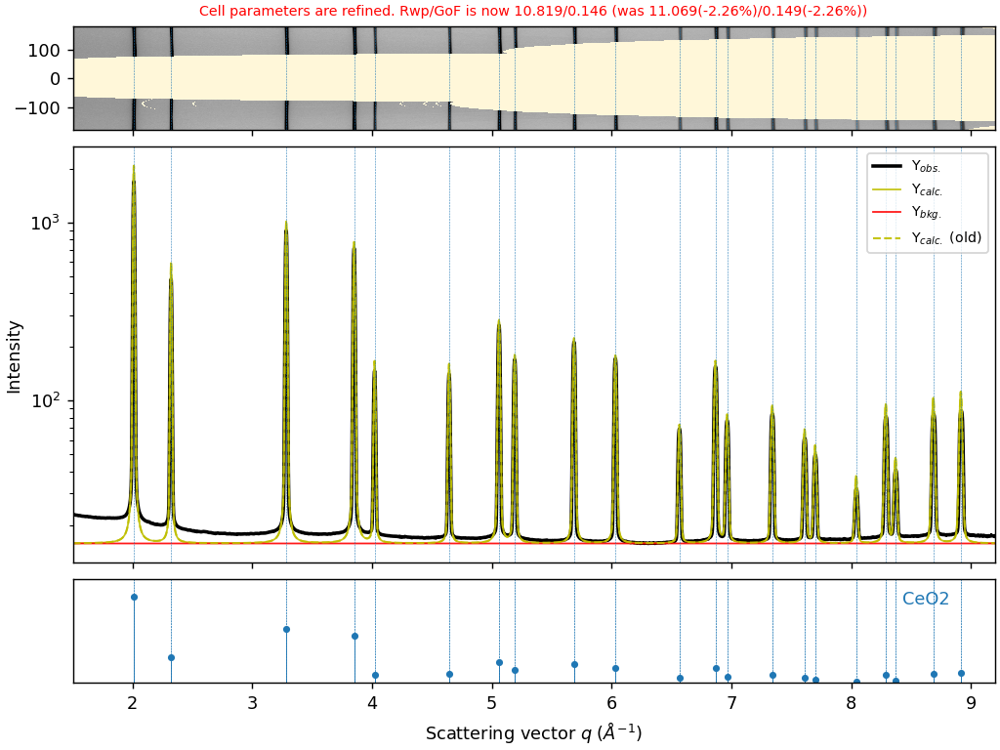

In [17]:
# Therefore, we can "help" refinement by manually changing the lattice parameters.
# For this, we need to use "scale" parameter in phases dict.

sample.load_phases(
    [{"mp_id": "mp-20194", "label": "CeO2", "scale": 0.99}],
    plot=True,
    mp_rester_api_key='dHgNQRNYSpuizBPZYYab75iJNMJYCklB',
    )


sample.setup_gsas2_refiner(plot=True, normalize=True, instprm_from_gpx='LaB6.gpx')
sample.refine_cell_parameters(plot=True)

 ✅--Background with 5 coeffs is refined. Rwp/GoF is now 7.334/0.099 (was 10.819(-32.21%)/0.146(-32.19%✨))
 ✅--Background with 10 coeffs is refined. Rwp/GoF is now 7.208/0.097 (was 7.334(-1.72%)/0.099(-1.69%))
 ✅--Background with 15 coeffs is refined. Rwp/GoF is now 7.200/0.097 (was 7.208(-0.10%)/0.097(-0.07%❗))


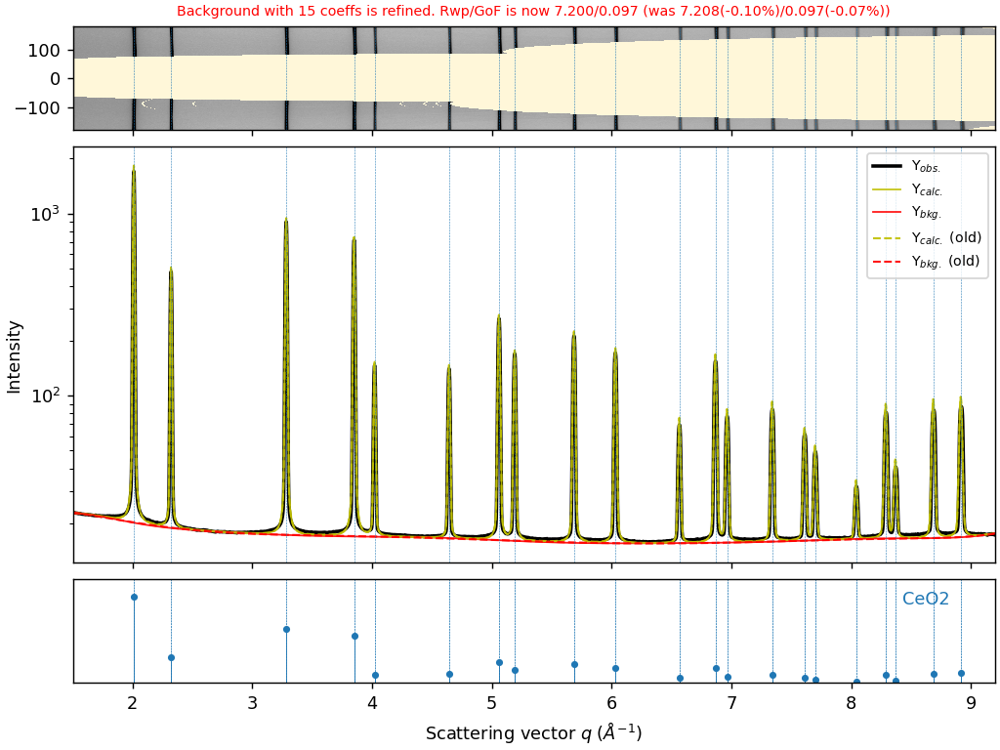

In [18]:
# Here we refine the background by gradually increasing the number of coefficients.

sample.refine_background(num_coeffs=5,plot=False)
sample.refine_background(num_coeffs=10,plot=False)
sample.refine_background(num_coeffs=15,plot=True)

 ✅--Size broadening of all phases are refined. Rwp/GoF is now 7.028/0.095 (was 7.200(-2.40%)/0.097(-2.48%))


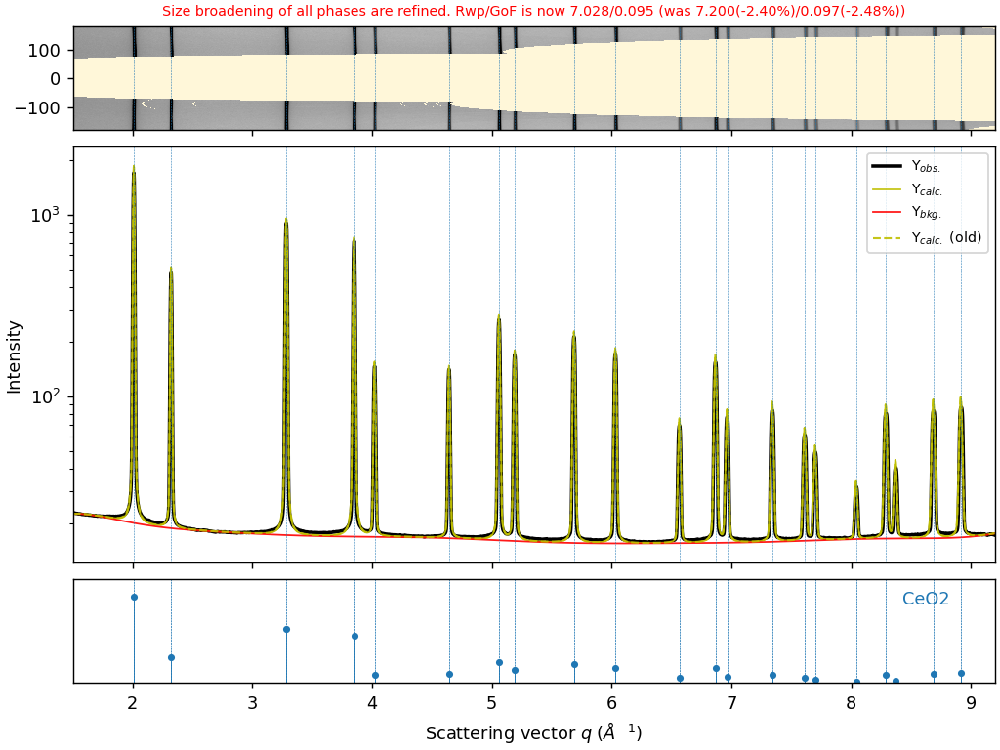

In [19]:
# Here we refine size broadening.

sample.refine_size_broadening(plot=True)

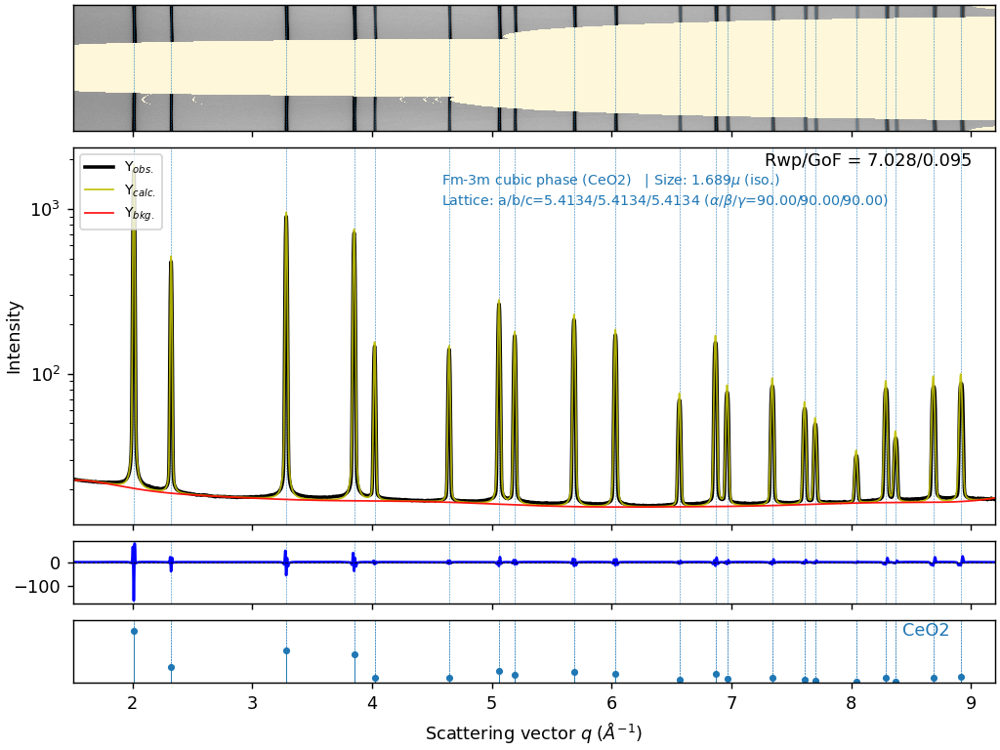

In [20]:
# This creates a final figure with LeBail refinement.

sample.plot()


 ✅--After setting LeBail refinement to True, Rwp/GoF is now 9.419/0.127 (was 7.028(34.03%)/0.095(34.02%❗))


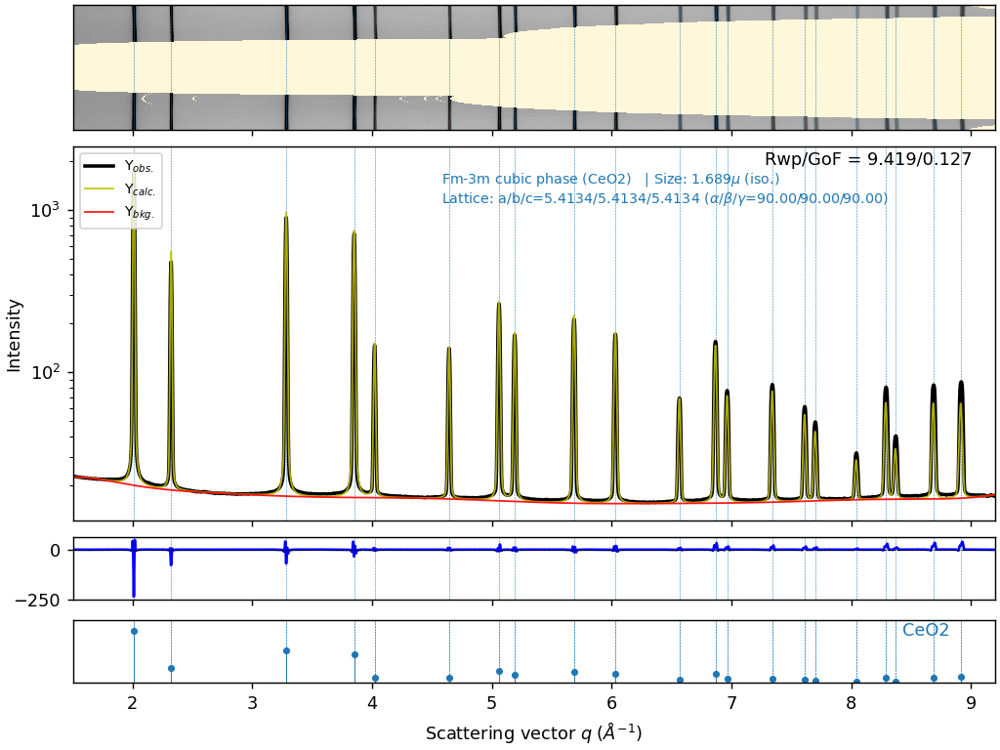

In [21]:
# Until now, we were doing Le-Bail refinements in which atom positions are not taken into consideration.
# We enable Rietveld by setting LeBail to false in GSAS settings.

sample.set_LeBail(to=False, refine=True, plot=False)
sample.plot()

# If you zoom in figure below, you will see the peak intensites got worse especially at high-q regions.

As next step, we can refine atom properties. Below is the screenshot of the GSAS-II window of this sample.

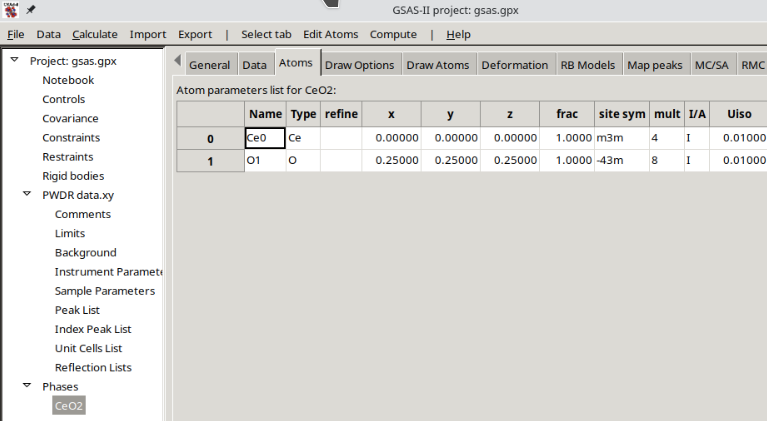![image.png](attachment:image.png)

There is not much to refine in atomic positions. But we can refine the U parameters of Ce and O sites as shown in next cell.

In [ ]:
sample.refine_site_property(site_ind=0,refinement_flags='U',plot=True) # This refines Uiso of Ce site
sample.refine_site_property(site_ind=1,refinement_flags='U',plot=True) # This refines Uiso of O site

# Note the improvement at high q values and Rwp/GoF, especially for Ce site.

 ✅--U property of Ce0 site of CeO2 phase is refined. Rwp/GoF is now 7.324/0.099 (was 9.419(-22.25%)/0.127(-22.24%✨))
 ✅--U property of O1 site of CeO2 phase is refined. Rwp/GoF is now 7.290/0.098 (was 7.324(-0.47%)/0.099(-0.47%❗))


In [ ]:
# This is the final plot

sample.plot()

In [ ]:
# The plot function here has more parameters. We can play with some of them here.

sample.plot(i1d_ylogscale=False) # Here we don't scale y-axis in log scale.
sample.plot(i2d_logscale=False) # Here we don't scale intensities in i2d in log scale.
sample.plot(site_str_x=0.5-0.15,site_str_y=0.8-0.2) # Here we move the info text inside the figure.
sample.plot(title='Rietvel refinement for CeO2') # Here we move the info text inside the figure.
sample.plot(export_fig_as='CeO2.pdf') # This creates a CeO2.pdf for high-resolution figures.
# See sample.plot? output for more details

# LaB6-CeO2-mix

Until now, we worked with pure LaB6 and CeO2 powders. Now we will work on a mix data of these materials.

Before that, we will read and integrate XRD of Kapton foil that was used during measurement of LaB6 and CeO2 powders.

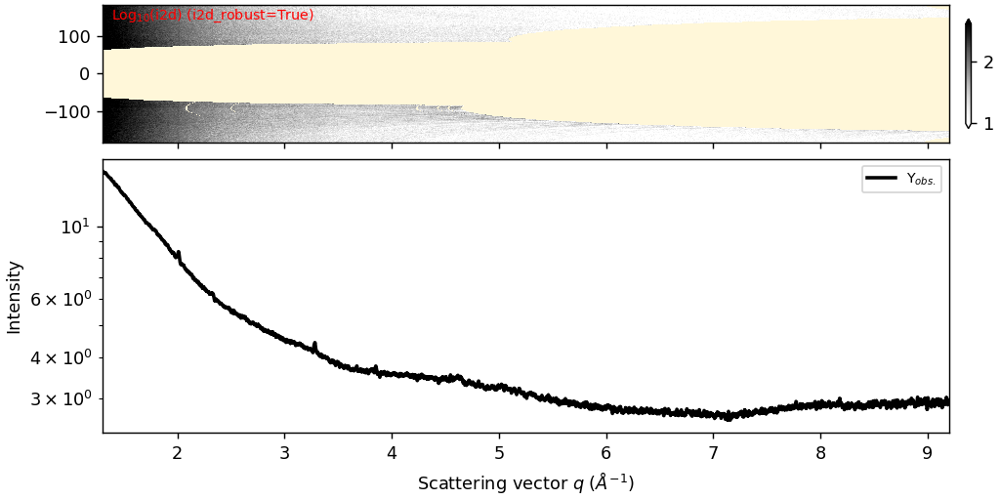

In [38]:
bkg = exrd()

bkg.load_xrd_data(
    from_tiff_file='Kapton/img.tiff',
    poni_file='geometry.poni',
    mask_file='mask.edf',
    radial_range=[1.3, 9.2]
    )

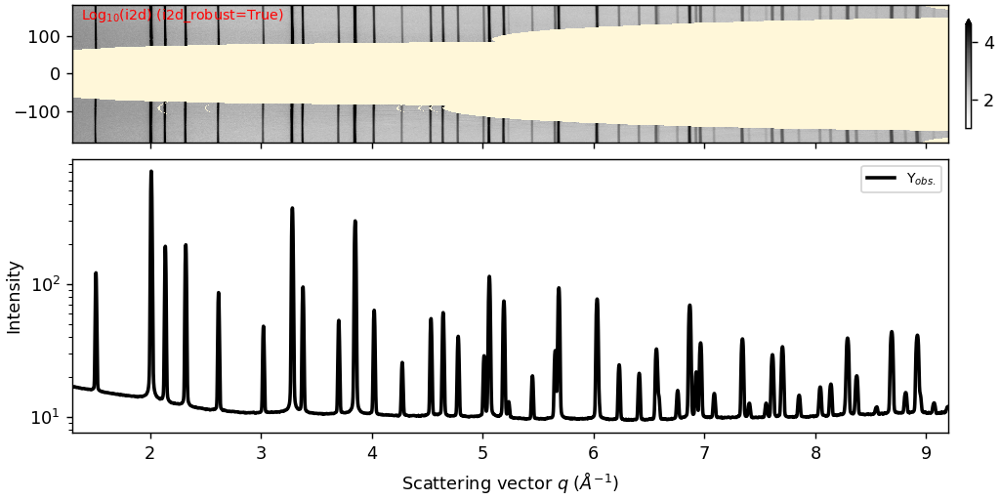

In [39]:
sample = exrd()

sample.load_xrd_data(
    from_tiff_file='LaB6_CeO2_mix/img.tiff',
    poni_file='geometry.poni',
    mask_file='mask.edf',
    radial_range=[1.3, 9.2]
    )

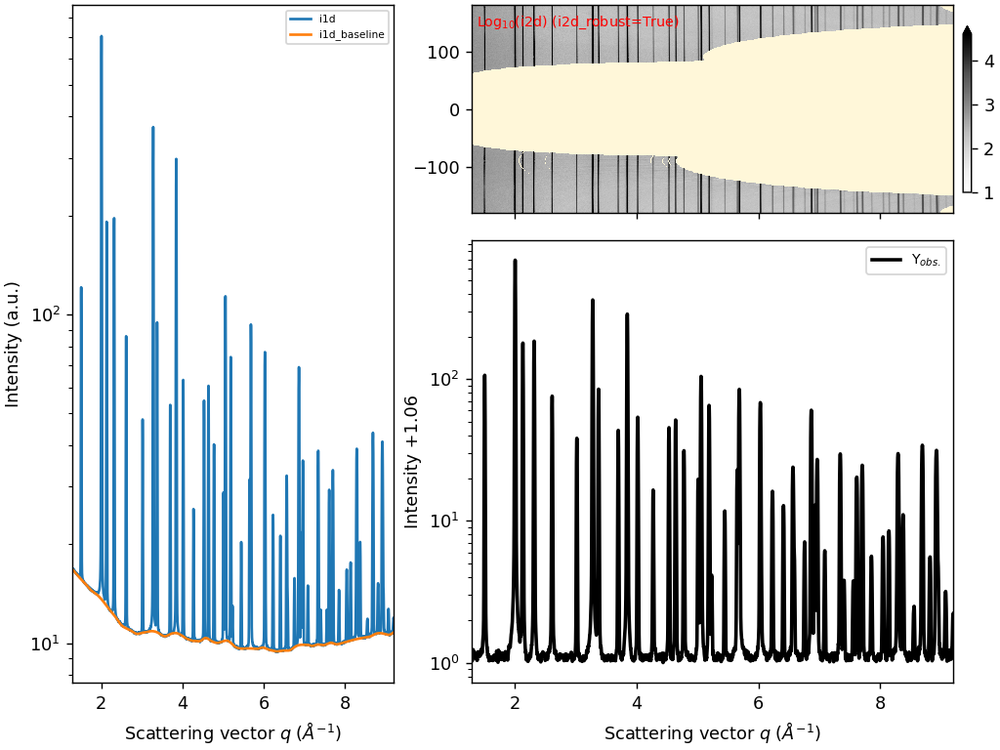

In [40]:
# Let's explore more details about get_baseline() feature of easyXRD.
#

sample.get_baseline()

# By default, it is using "iarpls (Improved Asymmetrically Reweighted Penalized Least Squares)"
# algorithm provided by pybaselines as in the note below:
# https://pybaselines.readthedocs.io/en/latest/algorithms/whittaker.html#iarpls-improved-asymmetrically-reweighted-penalized-least-squares

# It has a smoothing parameter, lam. Larger values will create smoother baselines. Default is 1e5.

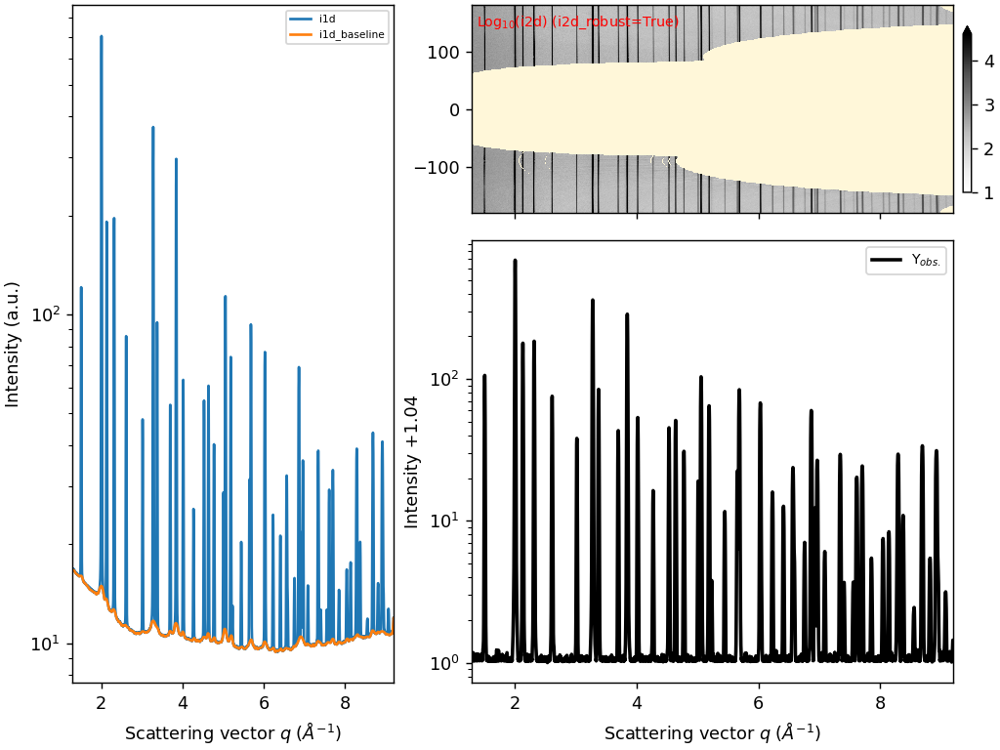

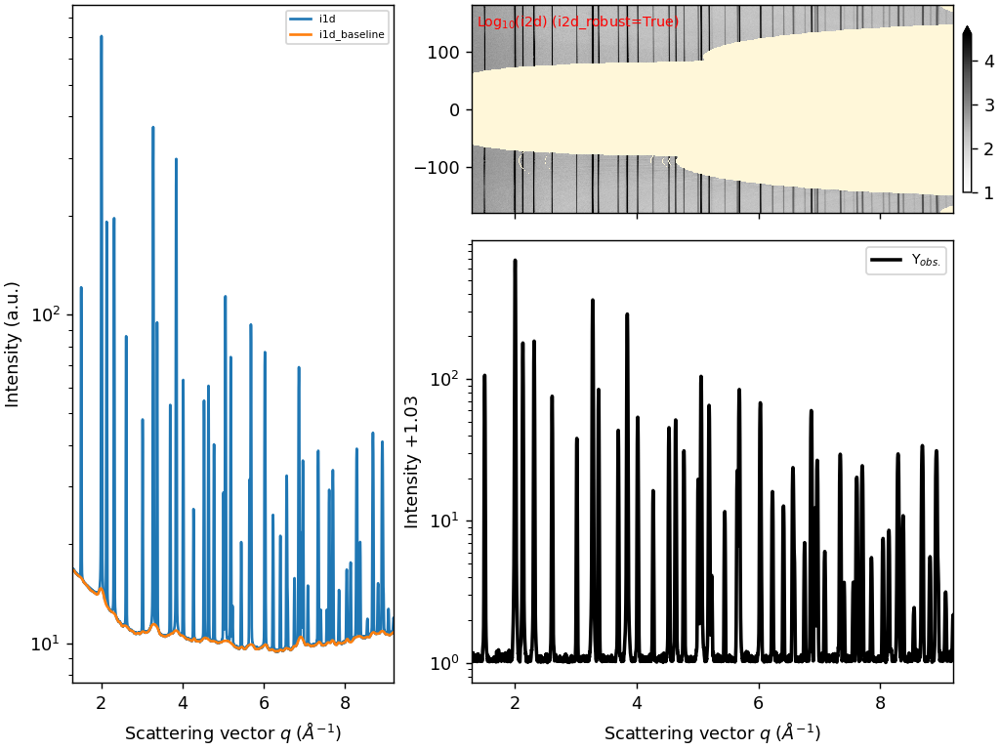

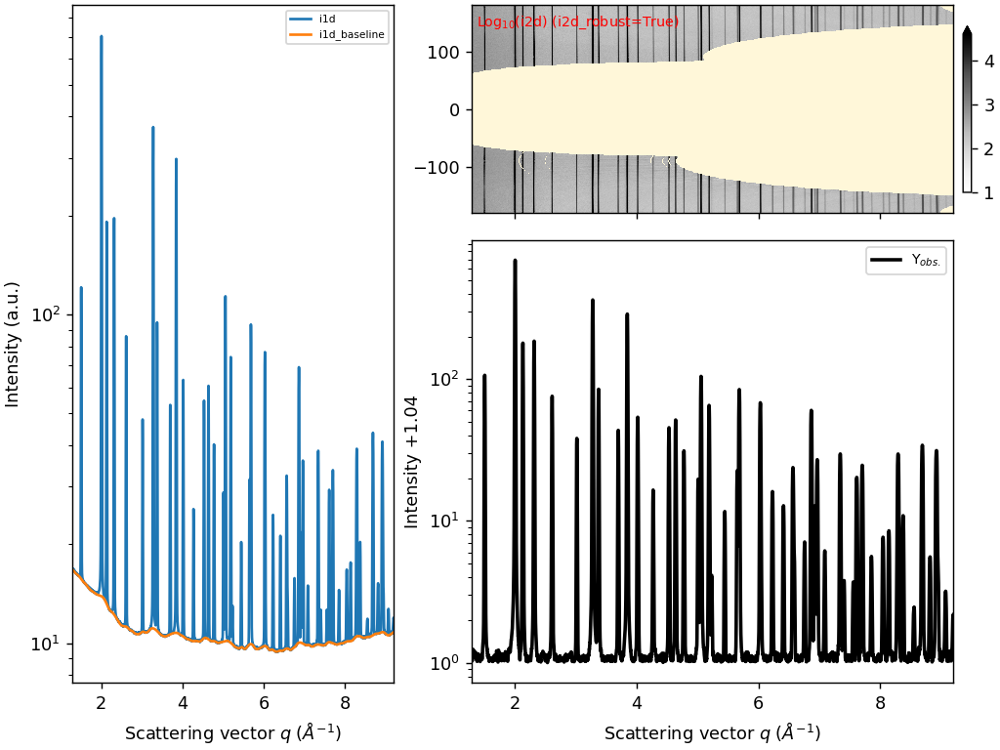

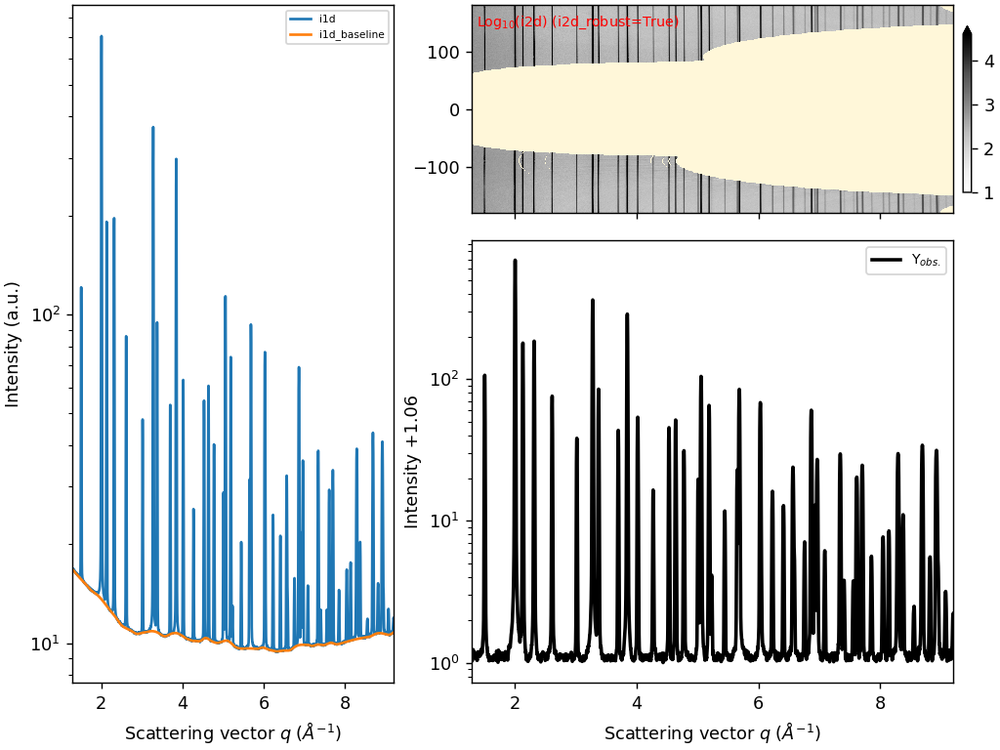

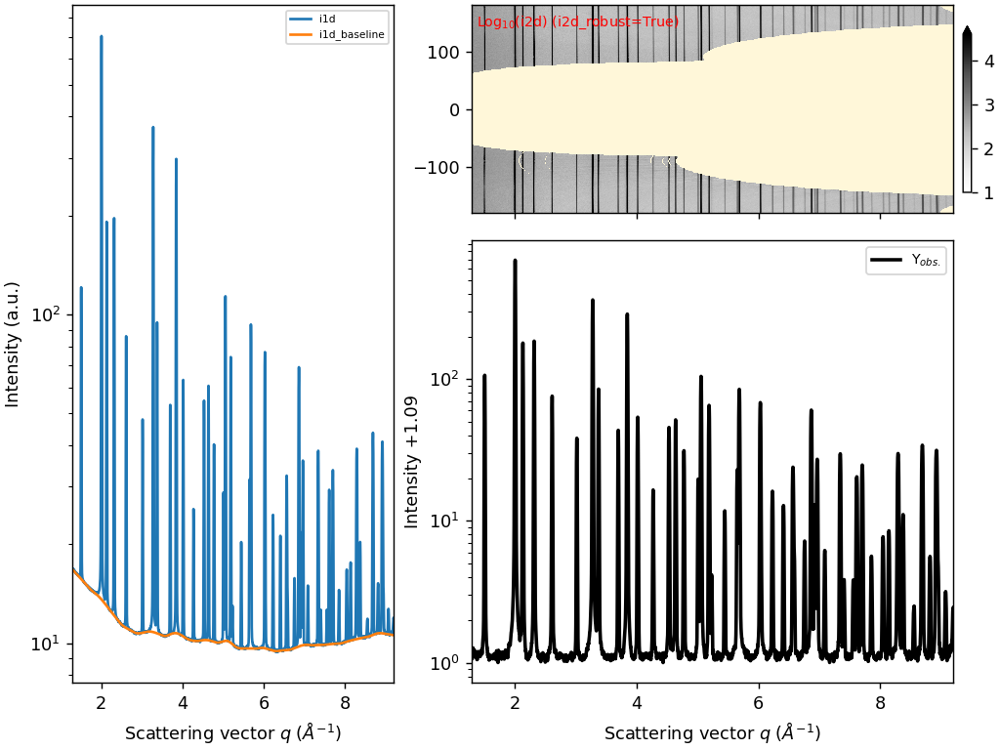

In [41]:
# We can easily vary iarpls_lam parameter from 1000 to 10000000 and see how it effects the estimated baseline.

sample.get_baseline(use_iarpls=True,iarpls_lam=1e2)
sample.get_baseline(use_iarpls=True,iarpls_lam=1e3)
sample.get_baseline(use_iarpls=True,iarpls_lam=1e4)
sample.get_baseline(use_iarpls=True,iarpls_lam=1e5)
sample.get_baseline(use_iarpls=True,iarpls_lam=1e6)

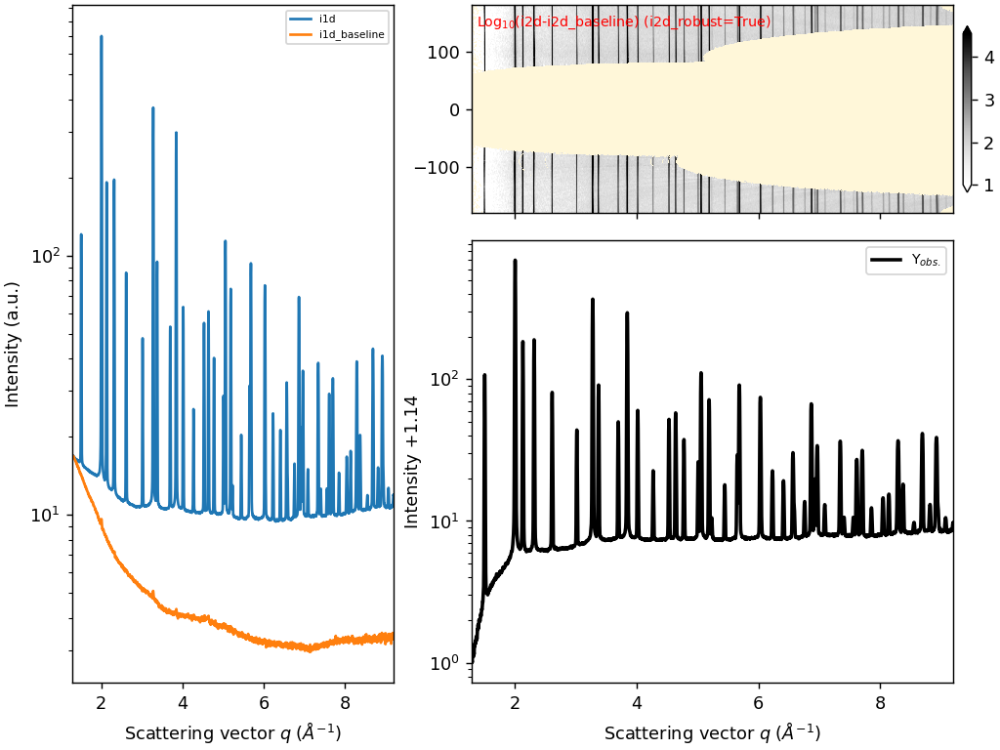

In [42]:
# Instead of estimating background with iarpls, we can use the Kapton data as shown below.
# The code automatically adjust the scaling parameter of input background until bbackground
# subtracted i1d doesn't have any negative values.

sample.get_baseline(input_bkg=bkg,use_iarpls=False)

Retrieving MaterialsDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

Retrieving MaterialsDoc documents:   0%|          | 0/1 [00:00<?, ?it/s]

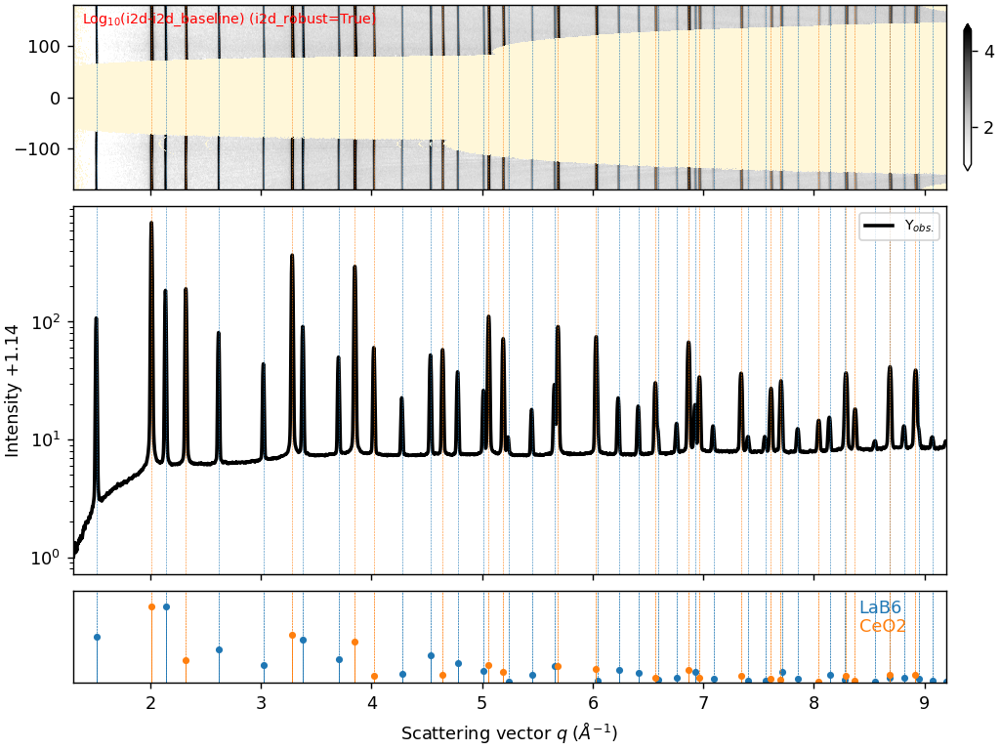

In [50]:
# Now we load phases from Materials Project

sample.load_phases(
    [
        {"mp_id": "mp-2680", "label": "LaB6",},
        {"mp_id": "mp-20194", "label": "CeO2", "scale": 0.99},
     ],
    plot=True,
    # mp_rester_api_key='....put-your-own-key-here....',
    mp_rester_api_key='dHgNQRNYSpuizBPZYYab75iJNMJYCklB',
    )


 ⏩--1st refinement with LeBail is completed. Rwp/GoF is now 36.484/0.612 (was 7.528(384.65%)/0.126(384.62%❗)) 

 ✅--Background with 5 coeffs is refined. Rwp/GoF is now 10.221/0.172 (was 36.484(-71.99%)/0.612(-71.98%✨))
 ✅--Background with 10 coeffs is refined. Rwp/GoF is now 10.187/0.171 (was 10.221(-0.33%)/0.172(-0.30%❗))
 ✅--Background with 15 coeffs is refined. Rwp/GoF is now 10.153/0.171 (was 10.187(-0.33%)/0.171(-0.30%❗))


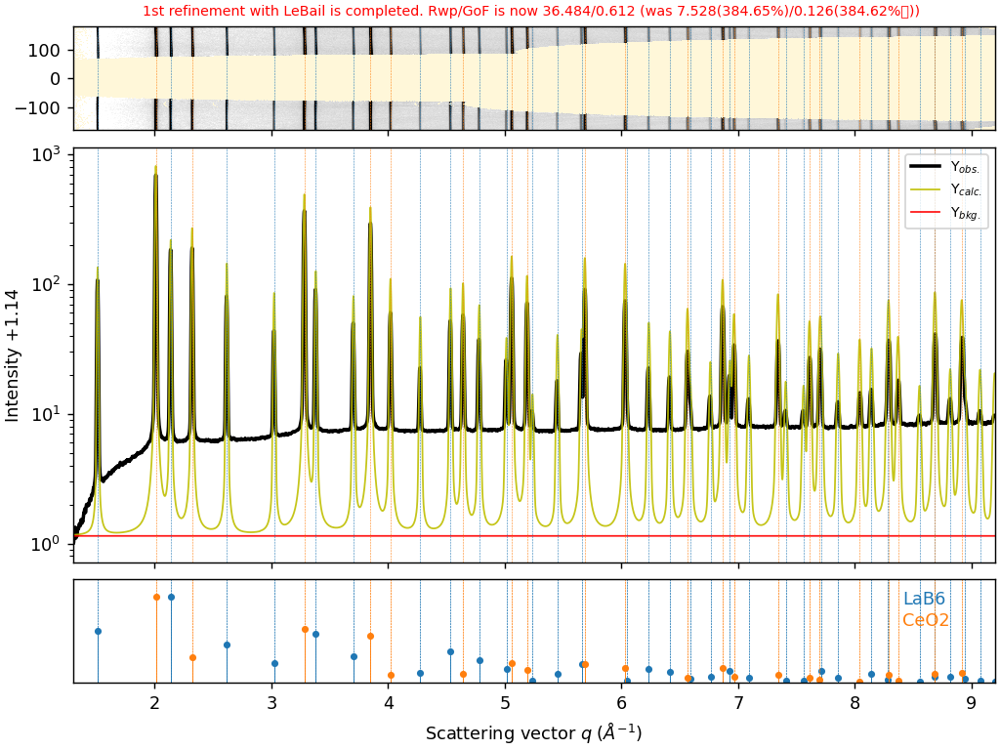

In [51]:
sample.setup_gsas2_refiner(plot=True, normalize=True, instprm_from_gpx='LaB6.gpx')
sample.refine_background(num_coeffs=5,plot=False)
sample.refine_background(num_coeffs=10,plot=False)
sample.refine_background(num_coeffs=15,plot=False)

 ✅--Cell parameters of all phases are refined. Rwp/GoF is now 7.151/0.120 (was 10.153(-29.57%)/0.171(-29.63%✨))


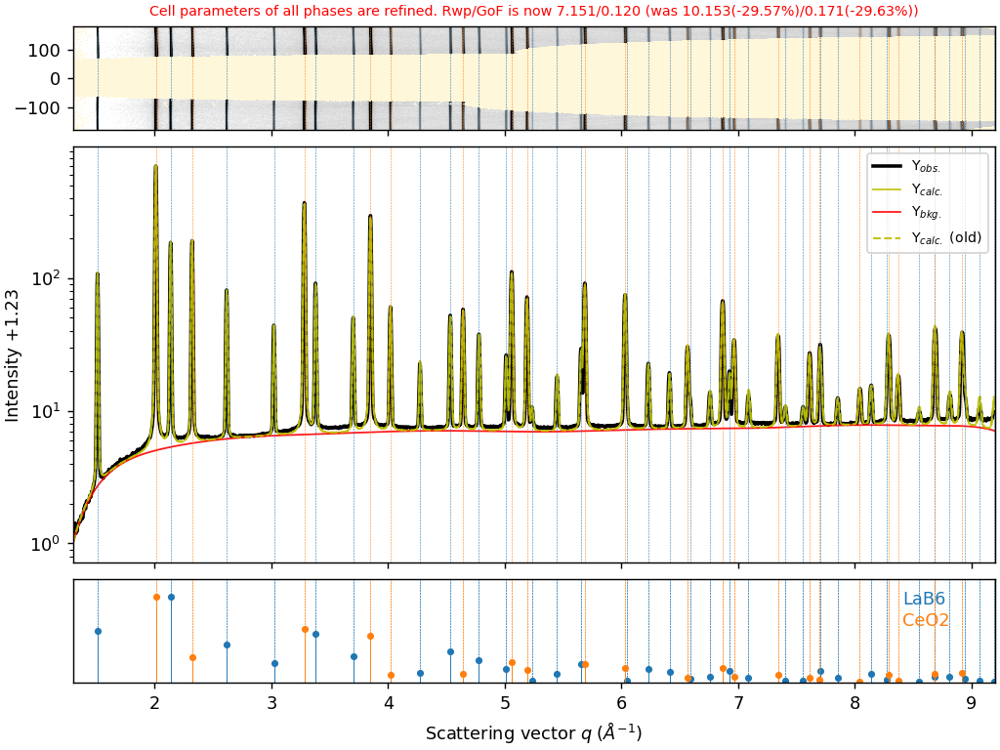

In [52]:
# We can refine cell parameters of LaB6 and CeO2 at the same time
sample.refine_cell_parameters(plot=True)

 ✅--Cell parameters of LaB6 phase are refined. Rwp/GoF is now 7.095/0.119 (was 7.151(-0.78%)/0.120(-0.79%❗))
 ✅--Cell parameters of CeO2 phase are refined. Rwp/GoF is now 7.078/0.119 (was 7.095(-0.24%)/0.119(-0.24%❗))


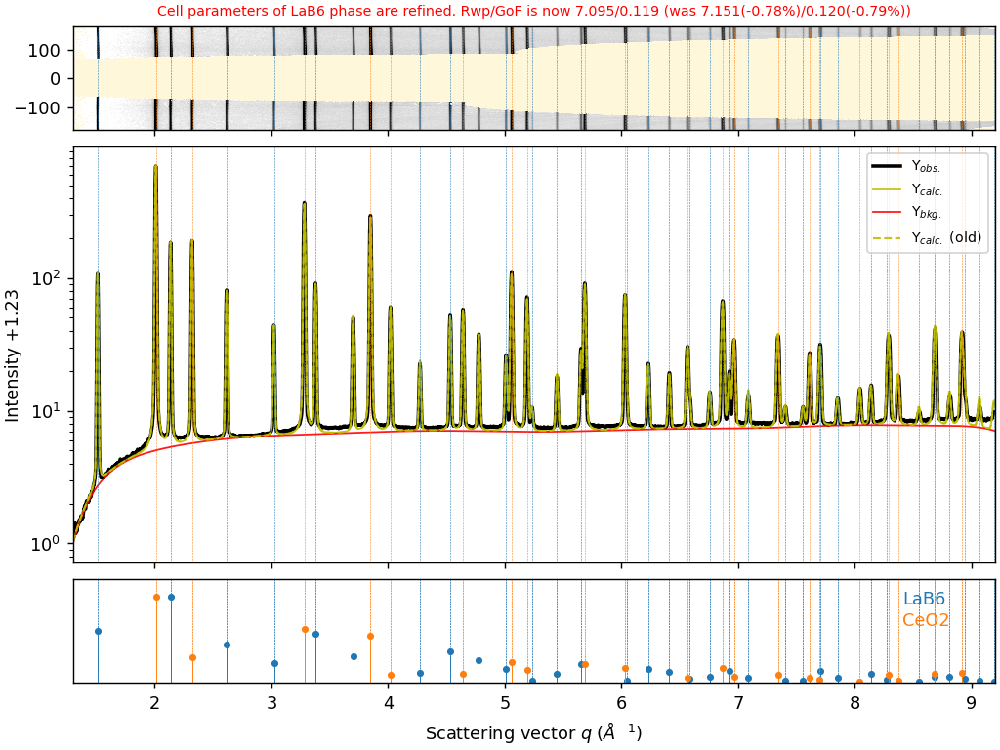

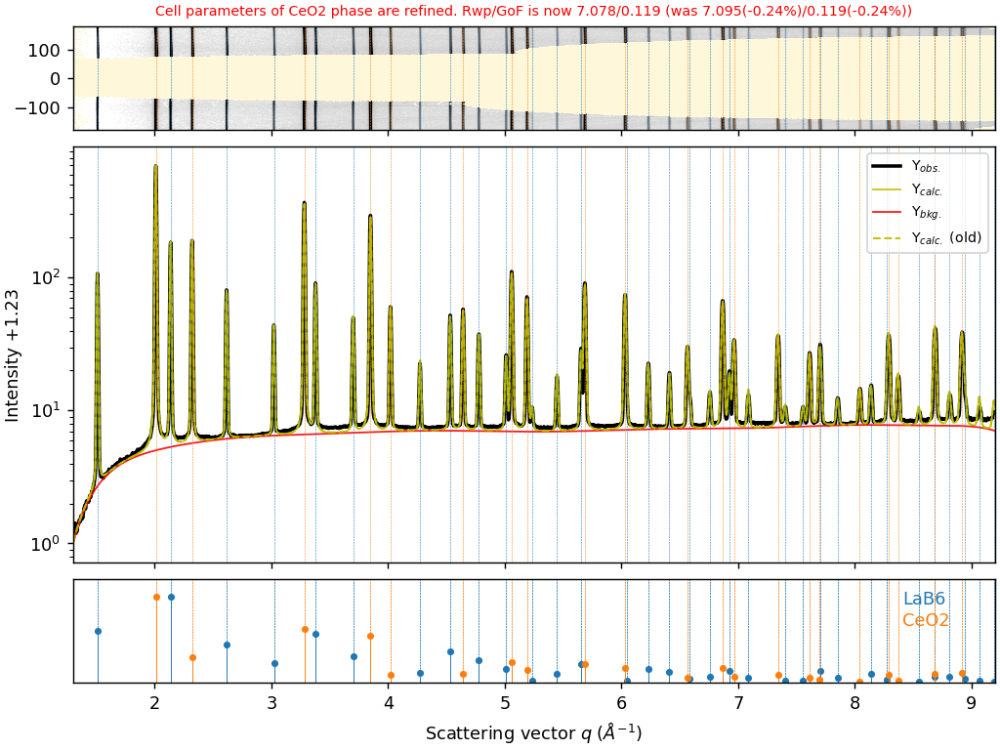

In [53]:
# or , they can be refined one-by-one
sample.refine_cell_parameters(plot=True,phase_ind=0)
sample.refine_cell_parameters(plot=True,phase_ind=1)


 ✅--After setting LeBail refinement to True, Rwp/GoF is now 10.693/0.179 (was 7.078(51.09%)/0.119(51.08%❗))


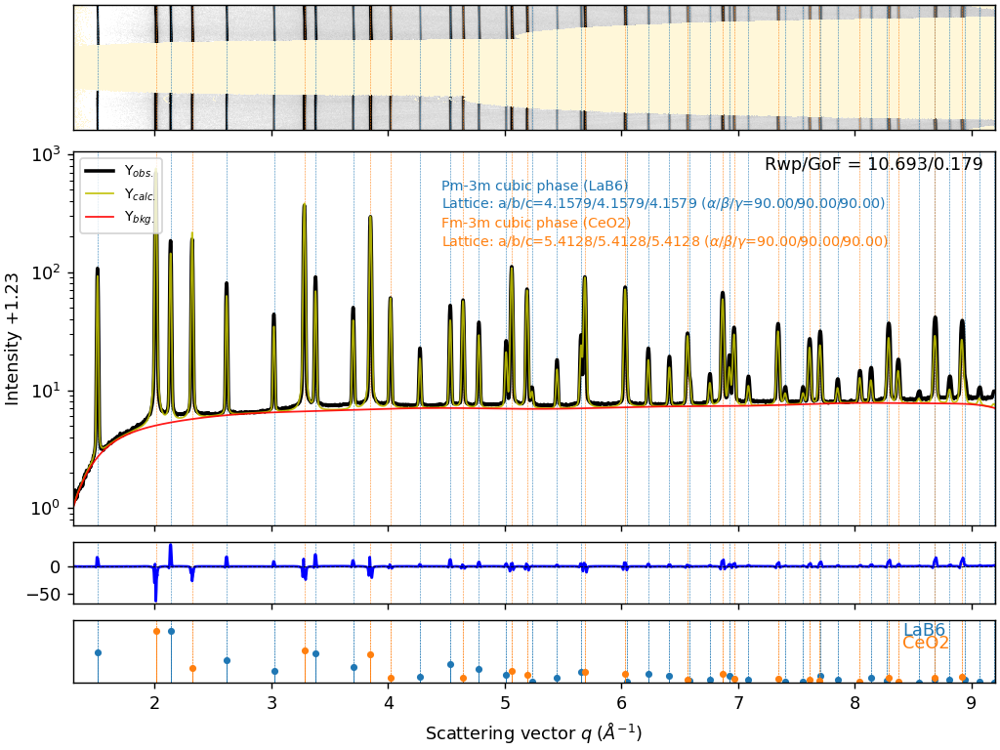

In [54]:
# Now we are enabling Rietveld type refinement.
sample.set_LeBail(to=False, refine=True, plot=False)
sample.plot()

 ✅--Phase fractions of all phases are refined. Rwp/GoF is now 8.850/0.149 (was 10.693(-17.24%)/0.179(-17.23%✨))


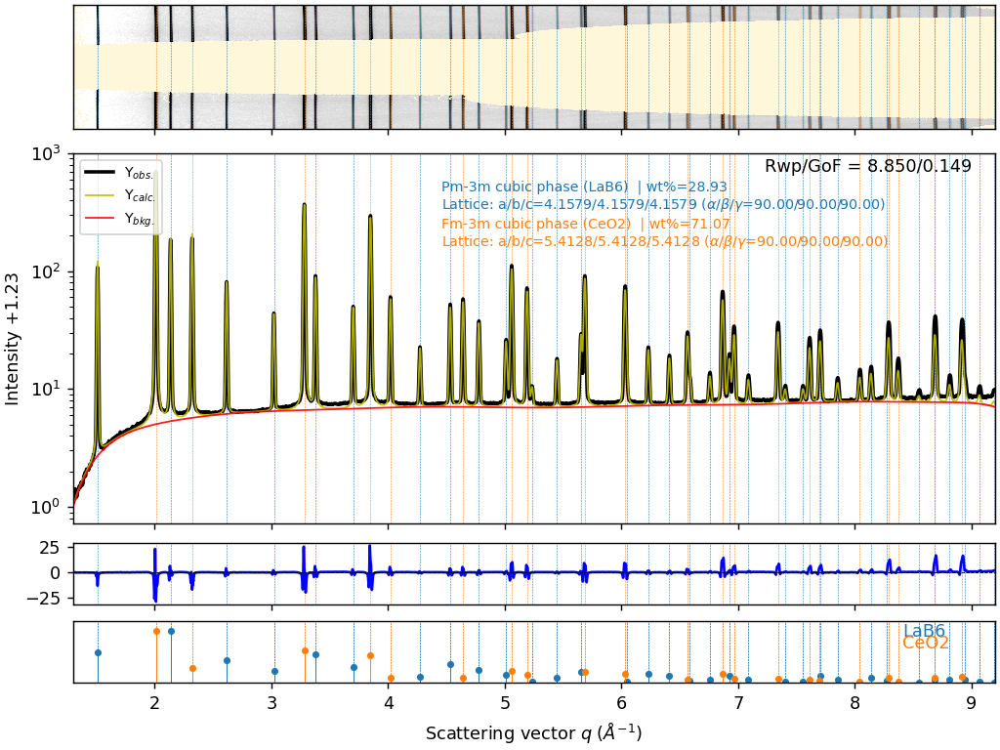

In [55]:
# For samples consisting of multiple phases, we need to refine phase fractions.
sample.refine_phase_fractions()
sample.plot(show_wt_fractions=True)

In [56]:
# Again we need to refine atom properties of CeO2 and LaB6 phases. Note phase_ind here.

sample.refine_site_property(phase_ind=0, site_ind=0,refinement_flags='U',plot=False) # This refines Uiso of La site
sample.refine_site_property(phase_ind=0, site_ind=1,refinement_flags='U',plot=False) # This refines Uiso of La site

sample.refine_site_property(phase_ind=1, site_ind=0,refinement_flags='U',plot=False) # This refines Uiso of Ce site
sample.refine_site_property(phase_ind=1, site_ind=1,refinement_flags='U',plot=False) # This refines Uiso of O site

 ✅--U property of La0 site of LaB6 phase is refined. Rwp/GoF is now 8.727/0.146 (was 8.850(-1.39%)/0.149(-1.39%))
 ✅--U property of B1 site of LaB6 phase is refined. Rwp/GoF is now 8.700/0.146 (was 8.727(-0.31%)/0.146(-0.31%❗))
 ✅--U property of Ce0 site of CeO2 phase is refined. Rwp/GoF is now 7.528/0.126 (was 8.700(-13.48%)/0.146(-13.48%✨))
 ✅--U property of O1 site of CeO2 phase is refined. Rwp/GoF is now 7.516/0.126 (was 7.528(-0.16%)/0.126(-0.16%❗))


 ✅--Background with 15 coeffs is refined. Rwp/GoF is now 7.367/0.124 (was 7.516(-1.97%)/0.126(-1.89%))
 ✅--Cell parameters of all phases are refined. Rwp/GoF is now 7.371/0.124 (was 7.367(0.05%)/0.124(-0.03%❗))
 ✅--Phase fractions of all phases are refined. Rwp/GoF is now 7.341/0.123 (was 7.371(-0.40%)/0.124(-0.41%❗))


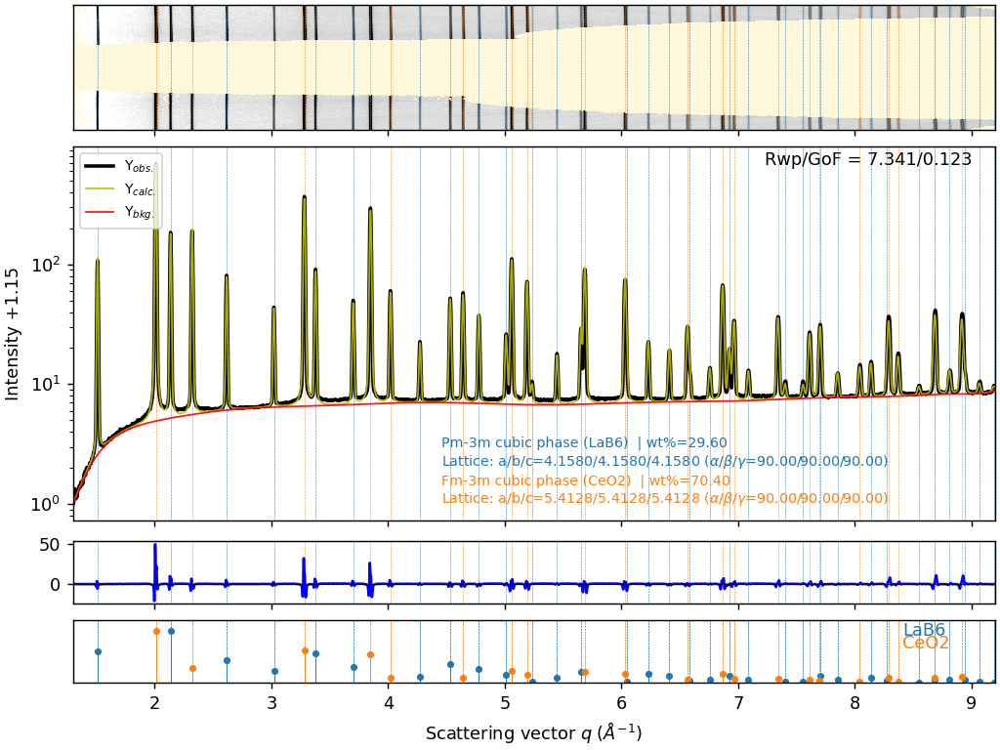

In [57]:
# It would be good to re-refine bakground, cell parameters, and wt fractions

sample.refine_background(num_coeffs=15,plot=False)
sample.refine_cell_parameters(plot=False)
sample.refine_phase_fractions(plot=False)

sample.plot(show_wt_fractions=True,site_str_y=0.1)